In [2]:
from os import path, getcwd
from sys import path as pythonpath
pythonpath.append(path.join(getcwd(), '..'))
import config_utils
import survey_footprints
import regions
import healpy as hp
from mw_plot import MWSkyMap, MWSkyMapBokeh
from astropy_healpix import HEALPix
from astropy import units as u
from astropy.coordinates import Galactic, TETE, SkyCoord, ICRS
from astropy.table import Table, Column
from astropy.io import ascii
import numpy as np
from sklearn.cluster import KMeans
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import json
from os import path
%matplotlib inline


# Configure path to local repository
root_dir = '/Users/rstreet/software/rgps'

# Load essential configuration
sim_config = config_utils.read_config(path.join(getcwd(), '..', 'config', 'sim_config.json'))

# HEALpixel grid resolution
NSIDE = sim_config['NSIDE']
PIXAREA = hp.nside2pixarea(NSIDE, degrees=True)

In [3]:
science_cases = config_utils.read_config(path.join(root_dir, 'config', 'rgps_science_cases.json'))

In [4]:
science_regions = regions.load_regions_from_file(sim_config,
                                                         path.join(root_dir, 'region_data', 'rgps_science_regions_spectroscopy.json'))

In [5]:
spectro_cases = {}
for author, info in science_cases.items():
    if 'P127' in info.keys() or 'G150' in info.keys():
        spectro_cases[author] = info

print('Number of spectroscopic science cases = ' + str(len(spectro_cases)))
print('\n')
for author, params in spectro_cases.items():
    print(author + ': ' + params['comment'])
    for optic in ['P127', 'G150']: 
        if optic in params.keys():
            for r in params[optic]:
                if 'l' in r.keys(): 
                    footprint = 'l: ' + repr(r['l']) + ', b:' + repr(r['b'])
                elif 'pointing' in r.keys():
                    footprint = 'pointing: ' + repr(r['pointing'])
                elif 'survey_footprint' in r.keys(): 
                    footprint = 'survey footprint: ' + r['survey_footprint'] 
                elif 'catalog' in r.keys():
                    footprint = 'catalog: ' + r['catalog']
                    
                print('  ' + optic + ' region=' + r['name'] + ' visit intervals=' + repr(r['visit_interval']) + ' footprint=' + footprint)

Number of spectroscopic science cases = 8


Anderson: Ionized Hydrogen in ISM.  F184 filter there could be other bright lines, so it may be difficult to isolate emission from Pa-alpha without G150 for at least a selected sub-region
  G150 region=HII1 visit intervals=[None] footprint=l: [-90.0, 90.0], b:[-2.5, 2.5]
Lim1: Young Stellar Object spectroscopy
  G150 region=YSO_spec1 visit intervals=[None] footprint=l: [55.0, 65.0], b:[-1.0, 1.0]
Rich2: Stellar populations; time domain survey of nuclear region
  P127 region=Rich_TDA1 visit intervals=[0.25] footprint=l: [359.544, 360.0], b:[-0.3, 0.3]
  P127 region=Rich_TDA2 visit intervals=[0.25] footprint=l: [0.0, 0.344], b:[-0.3, 0.3]
  G150 region=Rich_TDA1 visit intervals=[0.25] footprint=l: [359.544, 360.0], b:[-0.3, 0.3]
  G150 region=Rich_TDA2 visit intervals=[0.25] footprint=l: [0.0, 0.344], b:[-0.3, 0.3]
Lim3_grism_targets: W51, M17 and/or M16, in priority order, from Wanggi Lim
  G150 region=RGPS_M17 visit intervals=[None] footprint

In [6]:
spectro_regions = {} 
for author, info in spectro_cases.items(): 
    # Not all of the cases are sufficiently well defined as to enable regions to be built
    if author in science_regions.keys():
        spectro_regions[author] = science_regions[author]
    else: 
        print('Warning: science case for ' + author + ' is incompletely specified')
print('Regions defined for ' + str(len(spectro_regions)) + ' spectroscopic regions')

Regions defined for 8 spectroscopic regions


In [12]:
def merge_regions(sim_config, region_data, case_list):

    # Compile a list of regions for this optic over all science cases 
    region_list = []
    region_names = []
    
    for optic in sim_config['OPTICAL_COMPONENTS']: 

        for author in case_list:
            # Not all authors produced valid regions
            if author in region_data.keys():
                params = region_data[author]
                
                if optic in params.keys():
        
                    # Do not duplicate a region if an author has requested it for multiple filters
                    for r in params[optic]:
                        if r.name not in region_names:
                            region_list.append(r)
                            region_names.append(r.name)
    
    if len(region_list) > 0:
        r_merge = regions.combine_regions(region_list)
        r_merge.optic = 'ALL'
        r_merge.label = 'Merged survey footprint'
    else:
        r_merge = None 
        
    return r_merge, region_list

[<regions.CelestialRegion object at 0x12fc020d0>, <regions.CelestialRegion object at 0x12fc02a50>, <regions.CelestialRegion object at 0x12fc03fd0>, <regions.CelestialRegion object at 0x16119c3d0>, <regions.CelestialRegion object at 0x16119d210>, <regions.CelestialRegion object at 0x16119d490>, <regions.CelestialRegion object at 0x16119d650>, <regions.CelestialRegion object at 0x16119d9d0>, <regions.CelestialRegion object at 0x16119dc50>, <regions.CelestialRegion object at 0x16119de10>, <regions.CelestialRegion object at 0x16119dfd0>, <regions.CelestialRegion object at 0x16119e350>, <regions.CelestialRegion object at 0x16119e790>, <regions.CelestialRegion object at 0x16119e950>, <regions.CelestialRegion object at 0x16119ea10>, <regions.CelestialRegion object at 0x16119ead0>, <regions.CelestialRegion object at 0x16119eb90>, <regions.CelestialRegion object at 0x16119ec90>, <regions.CelestialRegion object at 0x16119ed50>, <regions.CelestialRegion object at 0x16119ee10>, <regions.CelestialR

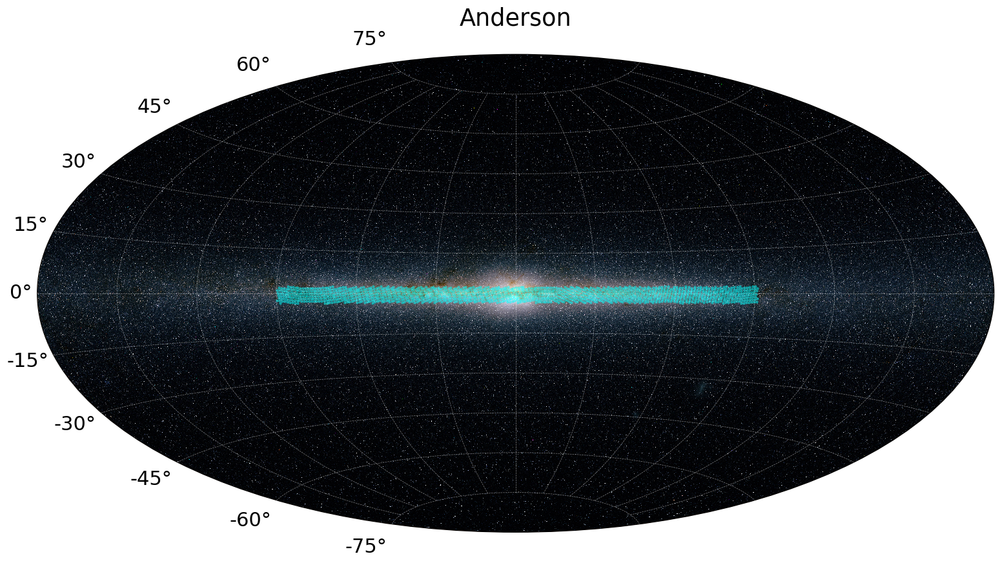

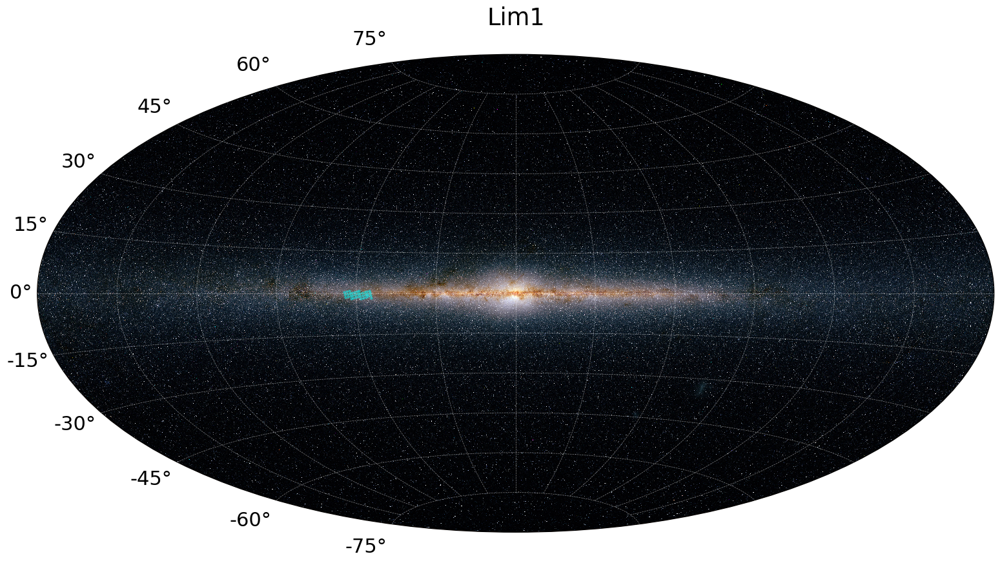

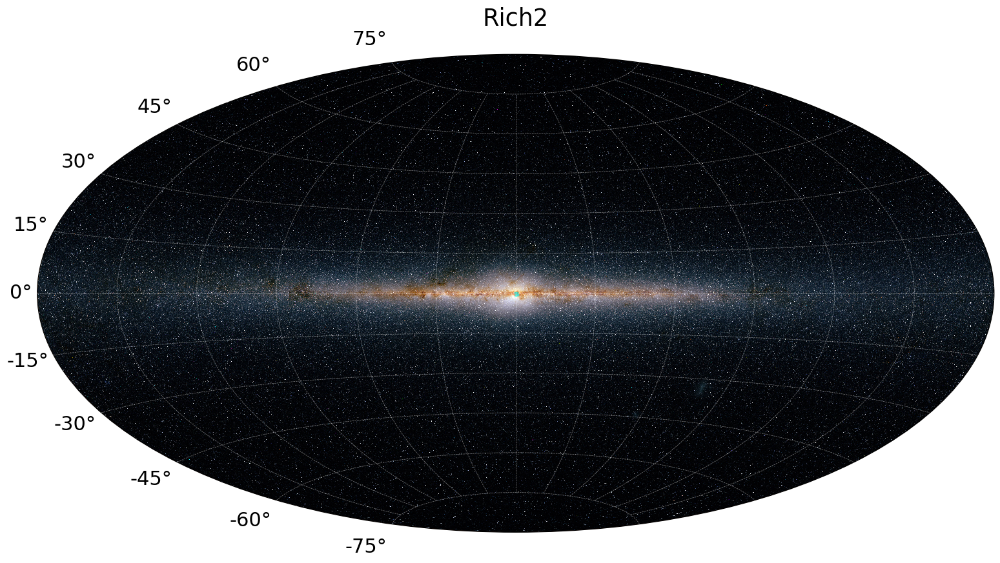

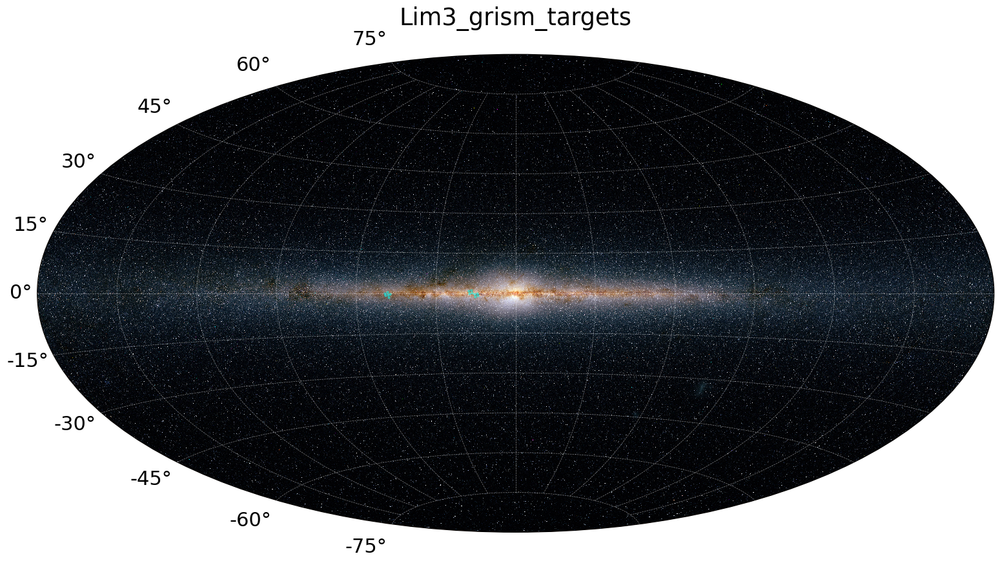

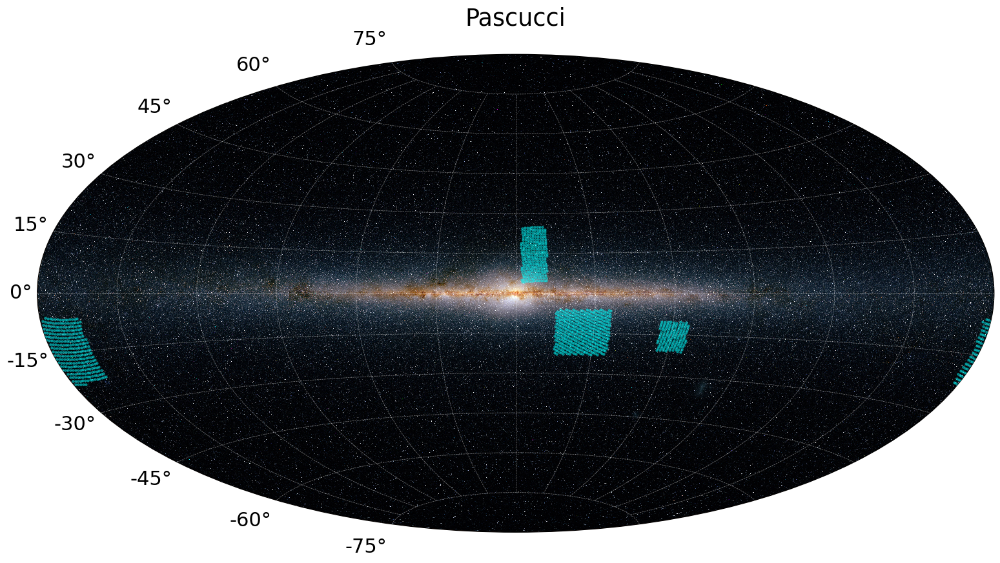

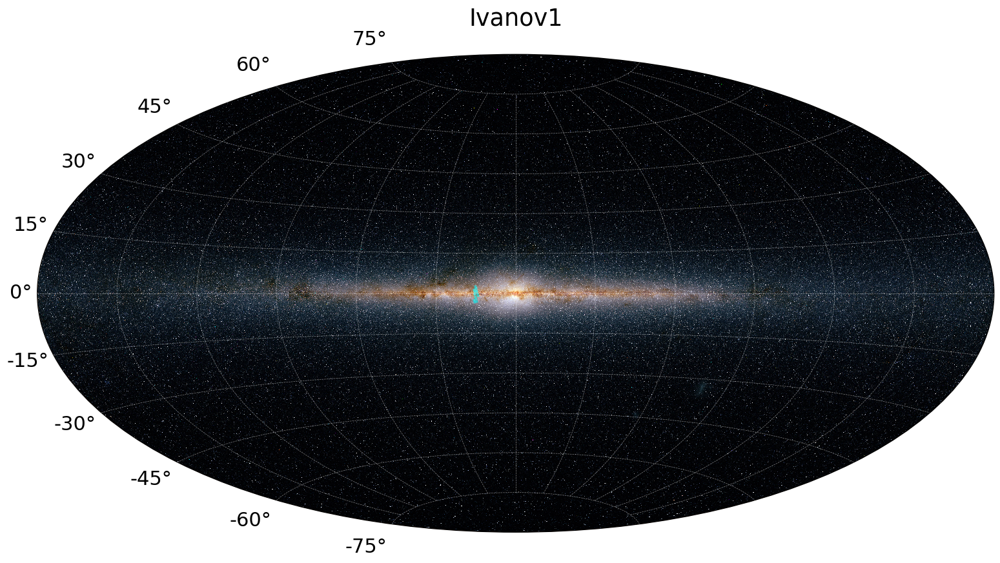

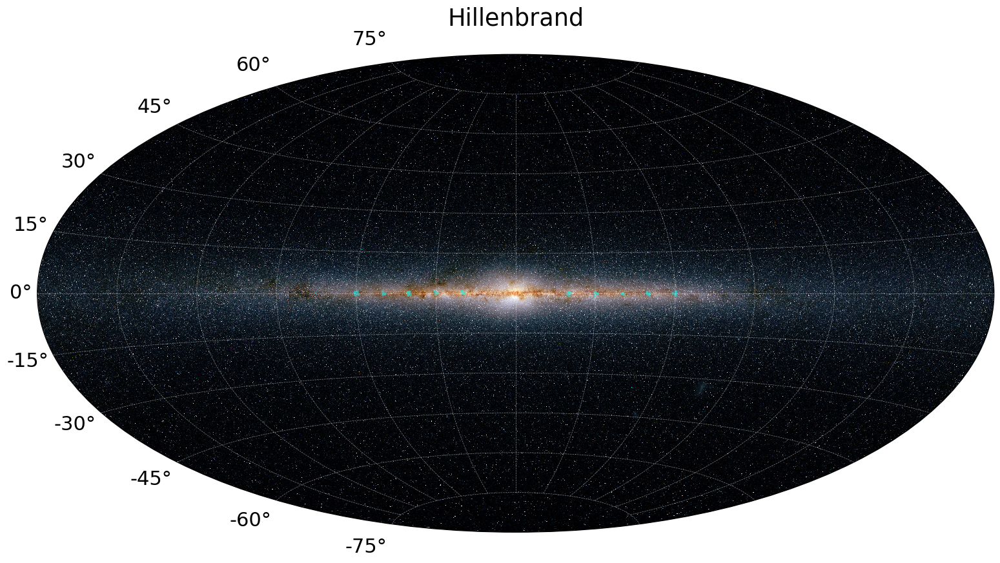

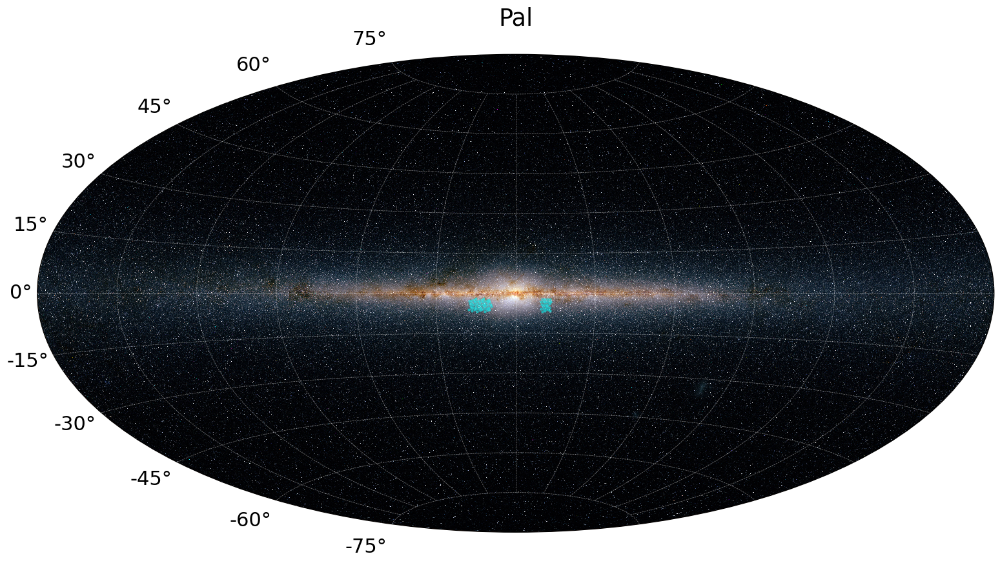

In [13]:
# Output plots of the regions requested for all time domain proposals 
all_region_list = []
for author, params in spectro_cases.items():
    r_merge, region_list = merge_regions(sim_config, spectro_regions, [author])
    all_region_list += region_list
    if r_merge:
        mw1 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
        mw1.title = author
        s = r_merge.pixels_to_skycoords()
        #mw1.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=r_merge.region_map[r_merge.pixels], cmap='Blues', s=5, alpha=0.4)
        mw1.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c='cyan', s=5, alpha=0.4)
        plt.rcParams.update({'font.size': 22})
        plt.tight_layout()
        plt.savefig(path.join(root_dir, 'spectroscopy', author+'_requested_regions_map.png'))

print(all_region_list)

In [14]:
r_spectro = regions.combine_regions(all_region_list)
r_spectro.optic = 'ALL'
r_spectro.label = 'Spectroscopic survey footprint'

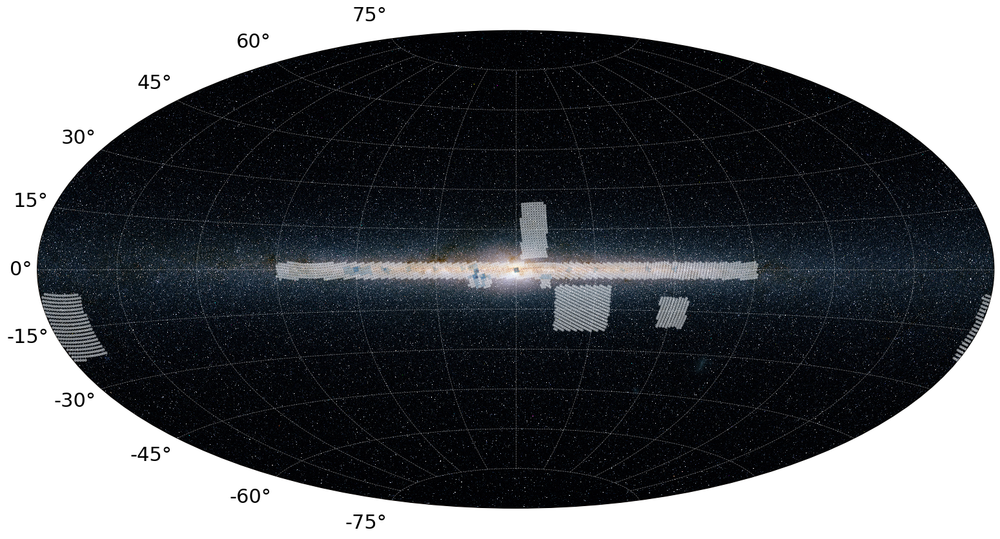

In [16]:
mw2 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
s = r_spectro.pixels_to_skycoords()
mw2.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=r_spectro.region_map[r_spectro.pixels], cmap='Blues', s=5, alpha=0.4)
plt.rcParams.update({'font.size': 22})
plt.tight_layout() 